In [1]:
import pandas as pd
import numpy as np
import cv2
import re
import glob
import matplotlib.pyplot as plt

In [2]:
def natural_sort_key(s, _nsre=re.compile('([0-9]+)')):
    return [
        int(text)
        if text.isdigit() else text.lower()
        for text in _nsre.split(s)]

Loaded 199 images and 198 annotations.


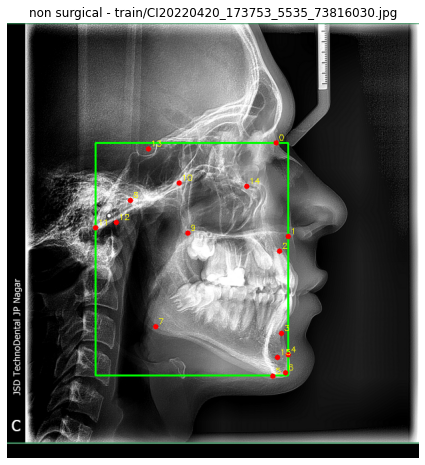

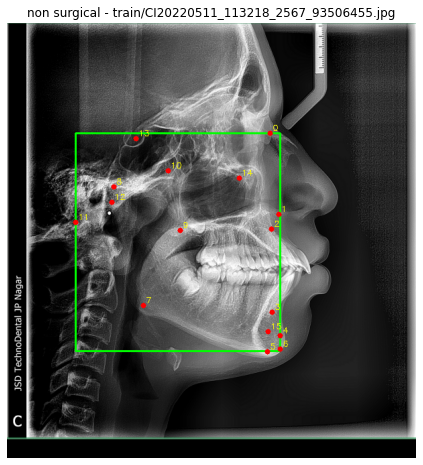

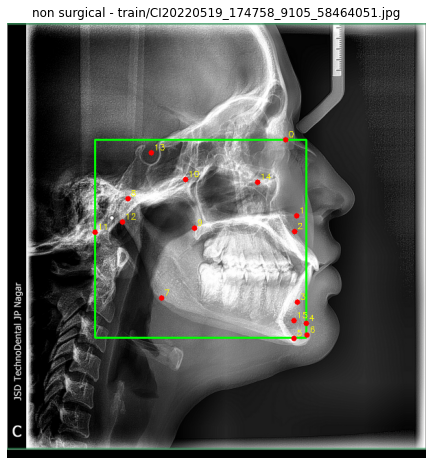

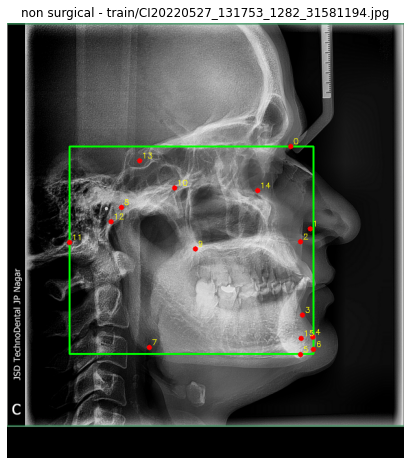

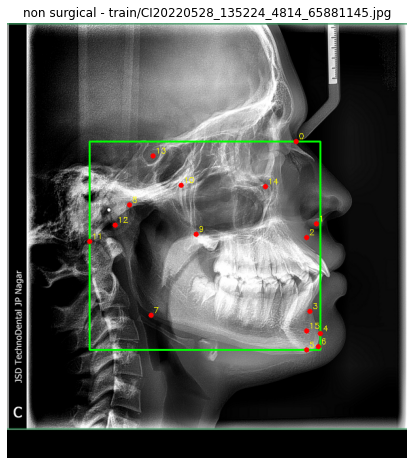

...

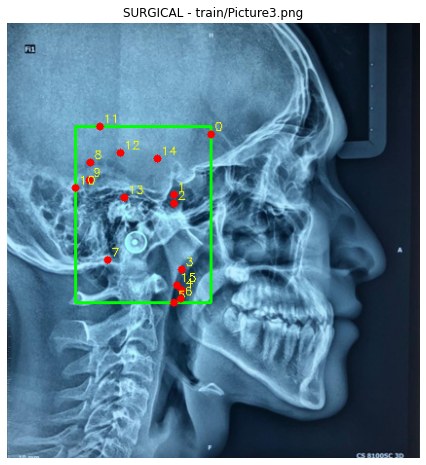

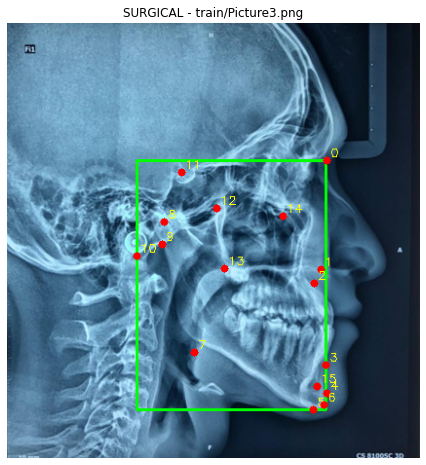

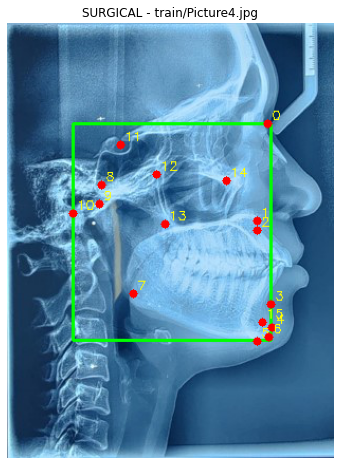

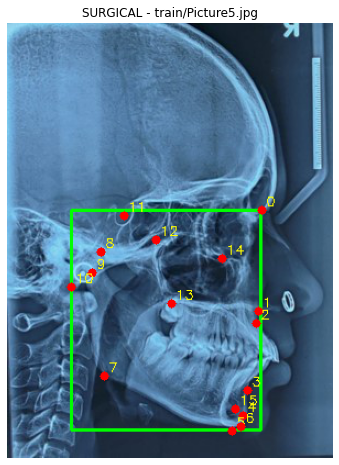

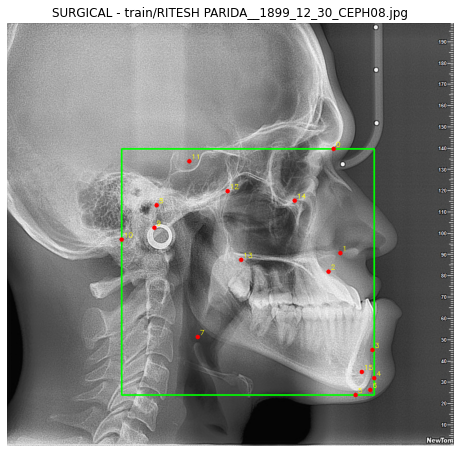

In [4]:
import json
import os
import cv2
import matplotlib.pyplot as plt

# ==== USER CONFIG ====
# Path to your COCO Keypoints 1.0 annotation file and image folder
ANNOTATION_FILE = "/Users/nebula/Desktop/Projects/Sanket/Dataset/train/annotation/n-person_keypoints_default.json"
IMAGE_DIR = "/Users/nebula/Desktop/Projects/Sanket/Dataset/"

# =====================

# Load COCO-style keypoints JSON
with open(ANNOTATION_FILE, 'r') as f:
    coco_data = json.load(f)

# Build lookup dictionaries for quick access
image_lookup = {img["id"]: img for img in coco_data["images"]}
category_lookup = {cat["id"]: cat for cat in coco_data["categories"]}

print(f"Loaded {len(coco_data['images'])} images and {len(coco_data['annotations'])} annotations.")

# Loop through each annotation and visualize
for ann in coco_data["annotations"]:
    image_info = image_lookup[ann["image_id"]]
    image_path = os.path.join(IMAGE_DIR, image_info["file_name"])

    if not os.path.exists(image_path):
        print(f"⚠️ Missing image: {image_path}")
        continue

    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    h, w, _ = img.shape
    keypoints = ann["keypoints"]
    category_id = ann["category_id"]
    category_name = category_lookup[category_id]["name"]

    # Optional bounding box
    if "bbox" in ann:
        x, y, bw, bh = map(int, ann["bbox"])
        cv2.rectangle(img, (x, y), (x + bw, y + bh), (0, 255, 0), 2)

    # Draw keypoints
    for i in range(0, len(keypoints), 3):
        x, y, v = keypoints[i:i+3]
        if v > 0:  # v=0 means not labeled; 1=labelled but not visible; 2=visible
            cv2.circle(img, (int(x), int(y)), 4, (255, 0, 0), -1)
            cv2.putText(img, str(i//3), (int(x)+4, int(y)-4),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.4, (255, 255, 0), 1)

    plt.figure(figsize=(8, 8))
    plt.imshow(img)
    plt.title(f"{category_name} - {image_info['file_name']}")
    plt.axis('off')
    plt.show()


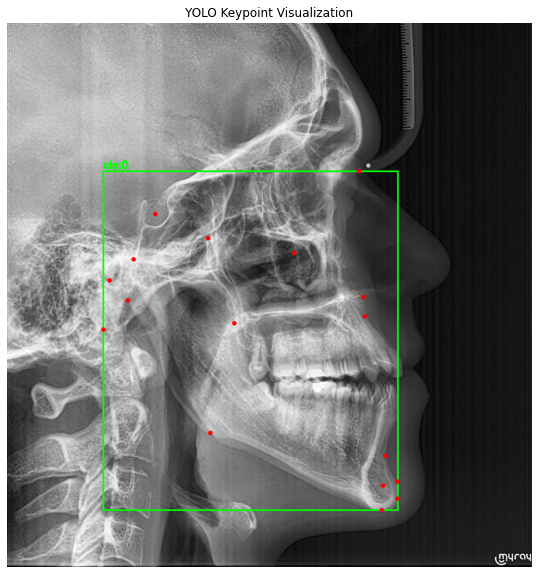

In [1]:
import cv2
import matplotlib.pyplot as plt
import os

# === CONFIGURATION ===
image_path = "/Users/nebula/Desktop/Projects/Sanket/Data/Recent_data/train/images/4.jpg"
label_path = "/Users/nebula/Desktop/Projects/Sanket/Data/Recent_data/train/labels/4.txt"

# === LOAD IMAGE ===
img = cv2.imread(image_path)
if img is None:
    raise FileNotFoundError(f"Image not found: {image_path}")

h, w = img.shape[:2]

# === LOAD LABEL (.txt) ===
if not os.path.exists(label_path):
    raise FileNotFoundError(f"Label not found: {label_path}")

with open(label_path, "r") as f:
    lines = f.readlines()

for line in lines:
    parts = line.strip().split()
    if len(parts) < 4:
        continue

    cls = int(parts[0])
    bbox = list(map(float, parts[1:5]))  # x_center, y_center, width, height (normalized)
    keypoints = list(map(float, parts[5:]))

    # === Convert bbox from normalized to pixel coords ===
    x_center, y_center, bw, bh = bbox
    x_center *= w
    y_center *= h
    bw *= w
    bh *= h
    x1 = int(x_center - bw / 2)
    y1 = int(y_center - bh / 2)
    x2 = int(x_center + bw / 2)
    y2 = int(y_center + bh / 2)

    # === Draw bounding box ===
    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(img, f"cls:{cls}", (x1, y1 - 5),
                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

    # === Draw keypoints (x, y, v triplets) ===
    for i in range(0, len(keypoints), 3):
        x = int(keypoints[i] * w)
        y = int(keypoints[i + 1] * h)
        v = int(keypoints[i + 2])  # visibility flag

        if v > 0:
            color = (0, 0, 255) if v == 2 else (255, 0, 0)
            cv2.circle(img, (x, y), 4, color, -1)

# === SHOW IMAGE ===
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10, 10))
plt.imshow(img_rgb)
plt.axis("off")
plt.title("YOLO Keypoint Visualization")
plt.show()
